# Skin Cancer Classification (Benign or Malignant)

#### Import Libraries

In [37]:
import warnings
warnings.filterwarnings('ignore')
import fiftyone as fo
import fiftyone.brain as fob
import fiftyone.zoo as foz
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
import cv2
import numpy as np
from typing import Tuple
import math
from skimage import filters
import pandas as pd
import seaborn as sns
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm
import time
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, roc_curve, auc, f1_score


##### Count samples per labels and check the image size

In [2]:
TRAIN_DATASET = Path("takehome/train")  
TEST_DATASET = Path("takehome/test")  

def count_samples(dataset):
    # Count number of images per class
    class_counts = {}
    image_sizes = set()

    for class_folder in dataset.iterdir():  
        if class_folder.is_dir() and class_folder.name in ['Benign', 'Malignant']:  
            num_images = len(list(class_folder.glob("*")))  
            class_counts[class_folder.name] = num_images

            # Check image sizes (sample a few images)
            for img_path in list(class_folder.glob("*"))[:15]:
                with Image.open(img_path) as img:
                    image_sizes.add(img.size)  # (width, height)
    return class_counts, image_sizes

print("Train Set: ")
train_class_counts, train_image_sizes = count_samples(TRAIN_DATASET)
print("Class Distribution:", train_class_counts)
print("Unique Image Sizes:", train_image_sizes)

print("Test Set: ")
test_class_counts, test_image_sizes = count_samples(TEST_DATASET)
print("Class Distribution:", test_class_counts)
print("Unique Image Sizes:", test_image_sizes)


Train Set: 
Class Distribution: {'Benign': 6289, 'Malignant': 5590}
Unique Image Sizes: {(224, 224)}
Test Set: 
Class Distribution: {'Benign': 1000, 'Malignant': 1000}
Unique Image Sizes: {(224, 224)}


## 1. Data Loading and Management

Load the data from different paths for each class and each type of dataset (train and test). Visualize a few samples.

In [3]:
TRAIN_BENIGN = TRAIN_DATASET / list(train_class_counts.keys())[0]
TRAIN_MALIGNANT = TRAIN_DATASET / list(train_class_counts.keys())[1]

TEST_BENIGN = TEST_DATASET / list(test_class_counts.keys())[0]
TEST_MALIGNANT = TEST_DATASET / list(test_class_counts.keys())[1]

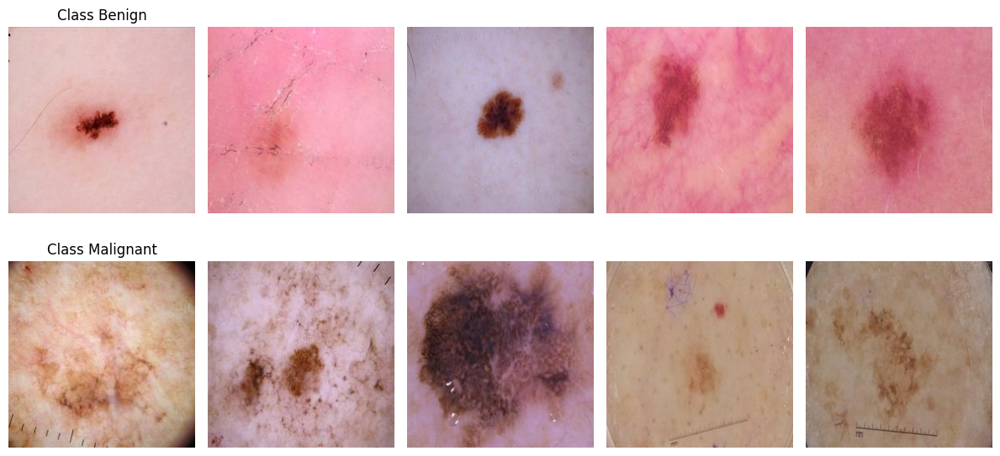

In [4]:
def plot_sample_images(dataset_path, class_labels, num_samples=5):
    fig, axes = plt.subplots(len(class_labels), num_samples, figsize=(12, 6))
    
    for i, label in enumerate(class_labels):
        class_folder = dataset_path / label
        images = list(class_folder.glob("*"))[:num_samples]  
        
        for j, img_path in enumerate(images):
            img = Image.open(img_path)
            axes[i, j].imshow(img)
            axes[i, j].axis('off')
            if j == 0:
                axes[i, j].set_title(f"Class {label}")

    plt.tight_layout()
    plt.show()

plot_sample_images(TRAIN_DATASET, train_class_counts.keys())


## 2. Data Preprocessing

Prepare the dataset for training - find quality issues and rectify mistakes in both trainset and testset

### A. Check for Data Quality Issues

Assess the visual quality of the dataset by analyzing key factors such as 

    - blurriness, 
    - sharpness, 
    - brightness, and 
    - darkness. 
    
By evaluating these attributes, we can identify potential data quality issues that may affect the performance of any model. 

#### Compute Blurry Images

OpenCV BlurDetection Algorithm: To compute blurry images using the OpenCV Blur Detection algorithm, we can use the Laplacian method, which measures the variance of the Laplacian operator applied to an image. 

A low variance indicates a blurry image, while a high variance indicates a sharp image.

In [5]:
# OpenCV BlurDetection Algorithm

def estimate_blur(image: np.array, threshold: int) -> Tuple[np.array, float, bool]:
    """
    Detects blurriness in an image using the Laplacian variance method.
    
    :param image: Input image as a NumPy array.
    :param threshold: Threshold below which an image is considered blurry.
    :return: Tuple (blur_map, score, is_blurry)
    """
    if image.ndim == 3:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    blur_map = cv2.Laplacian(image, cv2.CV_64F)
    
    score = np.var(blur_map)
    if threshold < 100:
        return score, score < threshold
    else: # outliers
        return score, score > threshold


def analyze_dataset(dataset_path: str, threshold: int):
    """
    Runs the blur detection algorithm over a dataset directory.
    
    :param dataset_path: Path to the dataset directory containing image folders.
    :param threshold: Blurriness threshold.
    """
    dataset_path = Path(dataset_path)
    blurry_images = []
    blurry_scores = []

    for img_path in dataset_path.rglob("*.*"): 
        if img_path.suffix.lower() not in [".jpg", ".png", ".jpeg", ".bmp"]:
            continue  

        image = cv2.imread(str(img_path))
        score, is_blurry = estimate_blur(image, threshold)
        blurry_scores.append(score)

        if is_blurry:
            blurry_images.append((img_path, score))

    print(f"Total blurry images found: {len(blurry_images)}")

    return blurry_scores, blurry_images


In [6]:
def plot_hist(scores, bins, task):
    scores = np.array(scores)

    plt.figure(figsize=(10, 5))
    plt.hist(scores, bins=bins, color="skyblue", edgecolor="black", alpha=0.7)
    plt.axvline(np.mean(scores), color="red", linestyle="dashed", linewidth=2, label=f"Mean {task}")
    plt.axvline(np.percentile(scores, 5), color="green", linestyle="dashed", linewidth=2, label="5th Percentile")
    plt.axvline(np.percentile(scores, 95), color="orange", linestyle="dashed", linewidth=2, label="95th Percentile")

    plt.xlabel(f"{task} Score")
    plt.ylabel("Frequency")
    plt.title(f"{task} Distribution Across Images")
    plt.legend()
    plt.grid(axis="y", linestyle="--", alpha=0.6)
    plt.show()

In [7]:
def plot_images(images, task, num_images=12, images_per_row=4):
    """
    Plots images in a grid layout with 4 images per row.

    :param images: List of tuples (image_path, score).
    :param task: Task description (e.g., 'blurred images', 'dark images').
    :param num_images: Number of images to display.
    :param images_per_row: Number of images per row in the grid.
    """
    print(f"\n Found {len(images)} {task} images, here are some samples:")

    if num_images > len(images):
        num_images = len(images)

    # Calculate number of rows needed
    num_rows = math.ceil(num_images / images_per_row)

    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(images_per_row * 4, num_rows * 4))
    axes = np.array(axes).reshape(num_rows, images_per_row)  

    for idx, (img_path, score) in enumerate(images[:num_images]):  
        image = cv2.imread(str(img_path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        row, col = divmod(idx, images_per_row)
        axes[row, col].imshow(image)
        axes[row, col].set_title(f"{img_path.name} | Score: {score:.2f}", fontsize=10)
        axes[row, col].axis("off")

    # Hide unused subplots
    for idx in range(num_images, num_rows * images_per_row):
        row, col = divmod(idx, images_per_row)
        axes[row, col].axis("off")

    plt.tight_layout()
    plt.show()


##### Low threshold, smoothed, and low Variance Images - Blurred

Total blurry images found: 17

 Found 17 Benign Class Blurriness images, here are some samples:


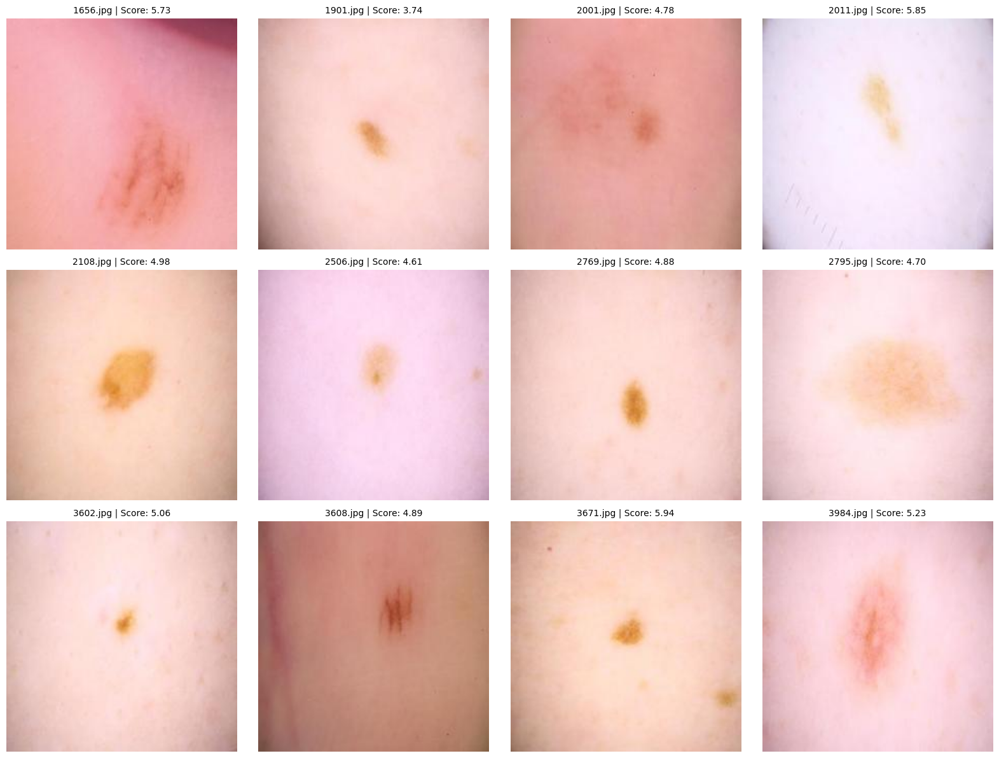

In [8]:
blurry_scores_b, blurry_images_b1 = analyze_dataset(TRAIN_BENIGN, threshold=6)
plot_images(blurry_images_b1, task= "Benign Class Blurriness")

Total blurry images found: 23

 Found 23 Malignant Class Blurriness images, here are some samples:


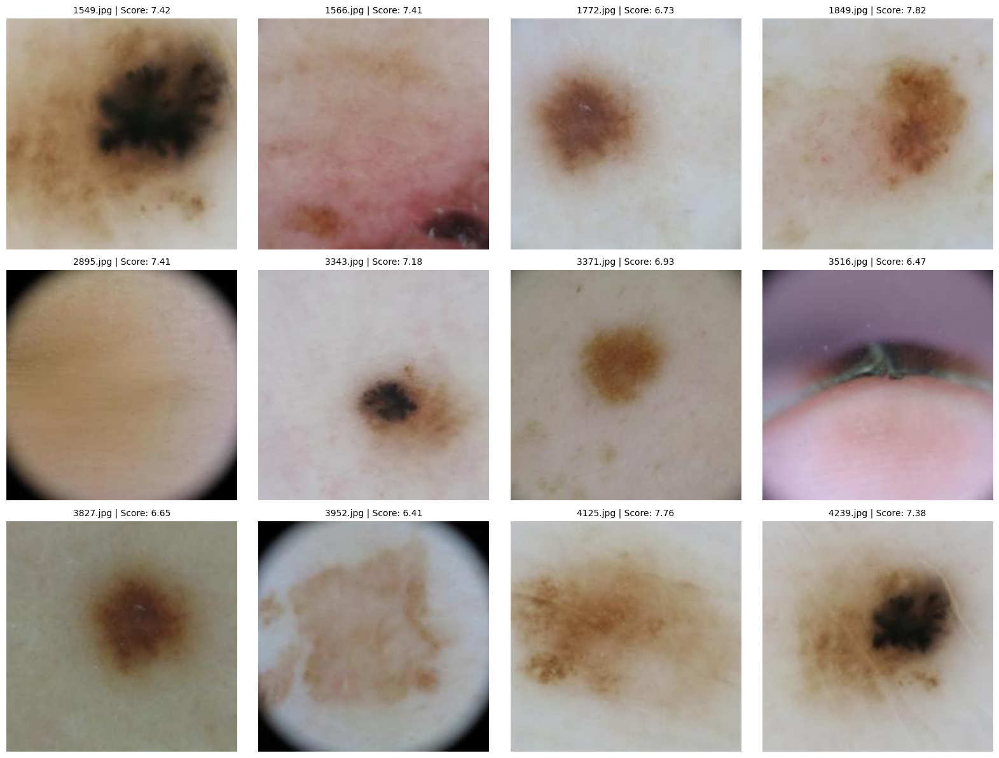

In [9]:
blurry_scores_m, blurry_images_m1 = analyze_dataset(TRAIN_MALIGNANT, threshold=8)
plot_images(blurry_images_m1, task= "Malignant Class Blurriness")

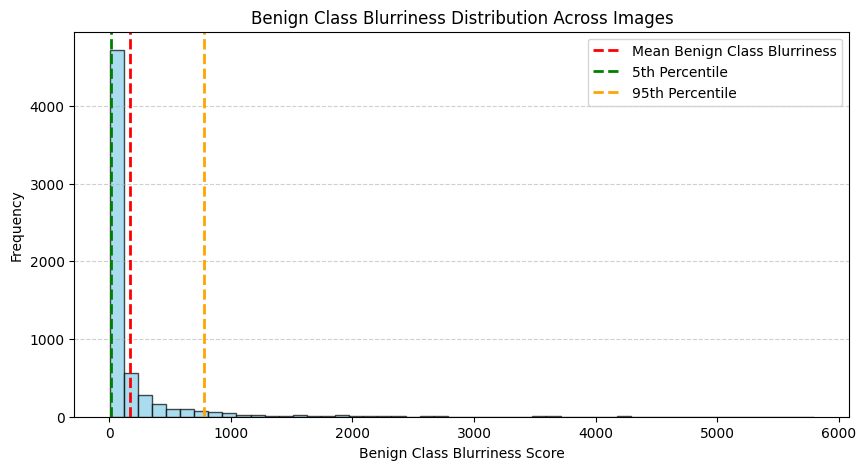

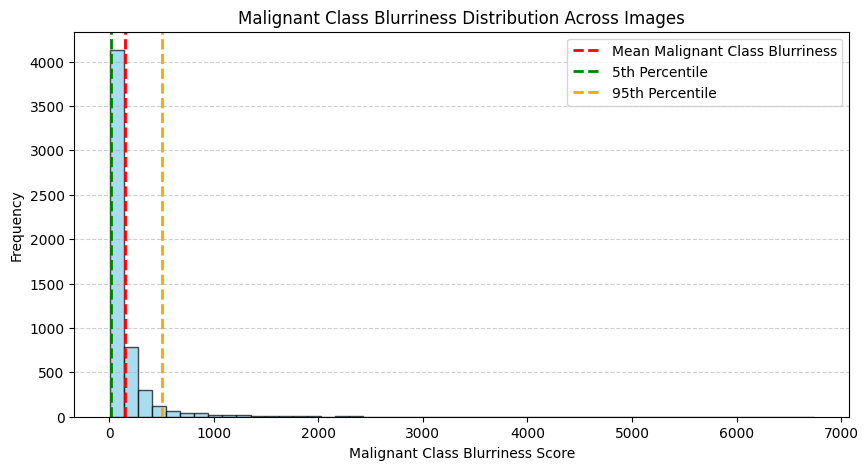

In [10]:
plot_hist(blurry_scores_b, bins=50, task= "Benign Class Blurriness")
plot_hist(blurry_scores_m, bins=50, task= "Malignant Class Blurriness")

##### Fix the blur - Sharpen the image

In [39]:
def sharpen_image(img):
    """Sharpen an image using an unsharp mask."""
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    return cv2.filter2D(img, -1, kernel)

def unsharp_mask(img, strength=1.5):
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    sharpened = cv2.addWeighted(img, strength, blurred, -0.5, 0)
    return sharpened

def laplacian_sharpen(img):
    laplacian = cv2.Laplacian(img, cv2.CV_64F)
    sharpened = cv2.convertScaleAbs(img - 0.5 * laplacian)
    return sharpened

def process_images(image_paths):
    """Apply preprocessing steps to a list of images and plot results."""
    
    fig, axes = plt.subplots(5, 4, figsize=(16, 20))
    fig.suptitle("Comparison of Sharpening Techniques\n")
    
    for idx, (img_path,_) in enumerate(image_paths[:5]):  # Process only first 5 images for visualization
        img = cv2.imread(img_path)
        if img is None:
            print(f"Error reading {img_path}")
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        sharpened1 = sharpen_image(img)
        sharpened2 = unsharp_mask(img)
        sharpened3 = laplacian_sharpen(img)
        
        axes[idx, 0].imshow(img)
        axes[idx, 0].set_title("Original Blurry Img")
        axes[idx, 0].axis("off")
        
        axes[idx, 1].imshow(sharpened1)
        axes[idx, 1].set_title("Kernel Sharpening")
        axes[idx, 1].axis("off")
        
        axes[idx, 2].imshow(sharpened2)
        axes[idx, 2].set_title("Unsharp Masking")
        axes[idx, 2].axis("off")
        
        axes[idx, 3].imshow(sharpened3)
        axes[idx, 3].set_title("Laplacian Sharpening")
        axes[idx, 3].axis("off")
    
    plt.tight_layout()
    plt.show()

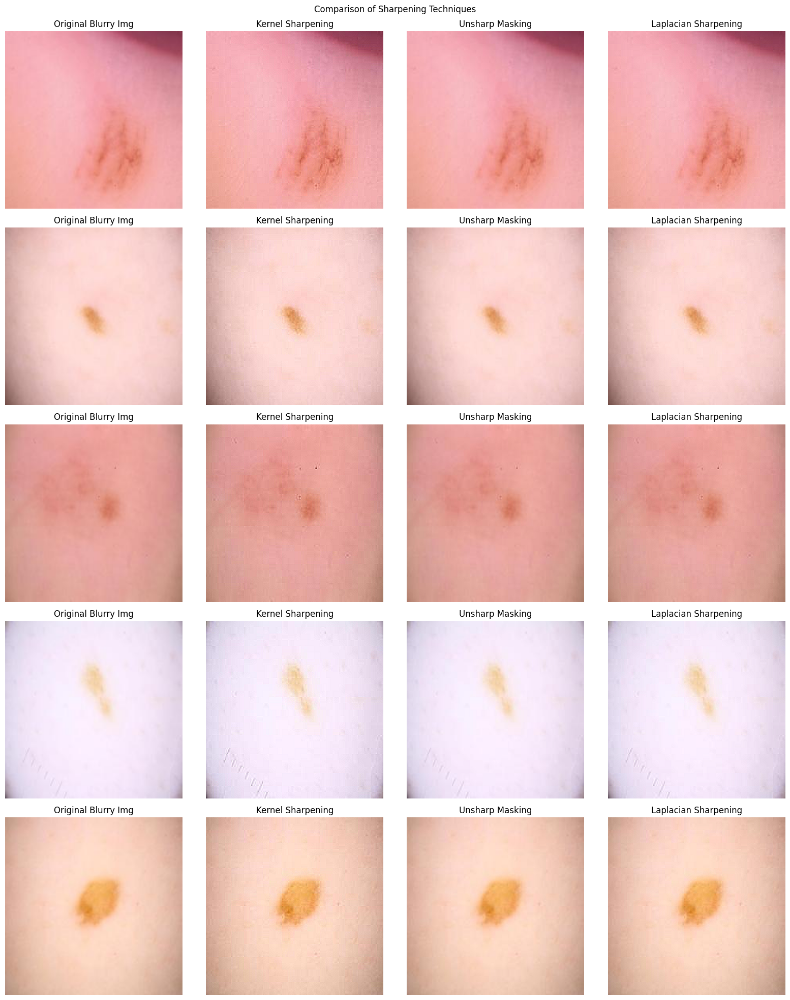

In [40]:
process_images(blurry_images_b1)

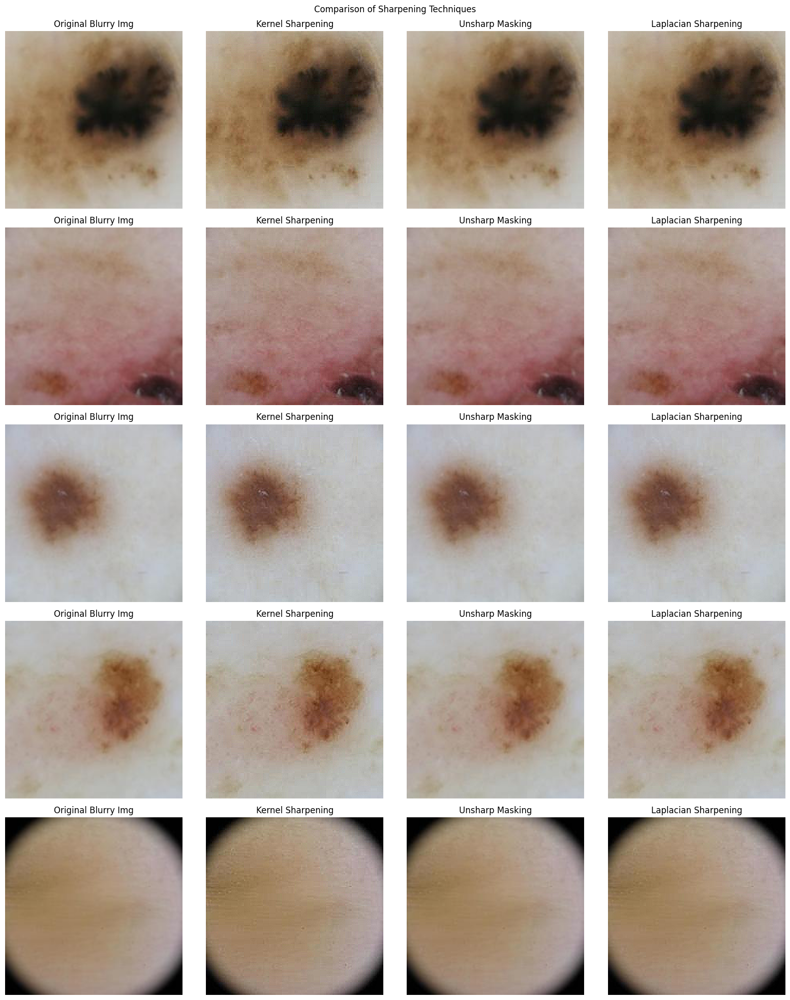

In [31]:
process_images(blurry_images_m1)

From visual inspection, kernel sharpening is better among all the three sharpening methods.

In [ ]:
def process_blurry_images(image_paths, output_folder):
    """Apply preprocessing steps to a list of images and plot results."""
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    sharpened_imgs = []

    for idx, (img_path,_) in enumerate(image_paths):  
        img = cv2.imread(img_path)
        # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        sharpened = sharpen_image(img)
        outpath = output_folder / img_path.name
        cv2.imwrite(outpath , sharpened)
        sharpened_imgs.append(outpath)
    return sharpened_imgs

sharpened_b1 = process_blurry_images(blurry_images_b1, TRAIN_DATASET / "sharpened/Benign")
sharpened_m1 = process_blurry_images(blurry_images_m1, TRAIN_DATASET / "sharpened/Malignant")

In [46]:
def analyze_sharp_dataset(dataset: list, threshold: int):
    blurry_images = []
    blurry_scores = []

    for idx, img_path in enumerate(dataset):  
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        score, is_blurry = estimate_blur(img, threshold)
        blurry_scores.append(score)

        if is_blurry:
            blurry_images.append((img_path, score))

    print(f"Total blurry images found: {len(blurry_images)}")

    return blurry_scores, blurry_images

In [48]:
blurry_scores_s1, blurry_images_s1 = analyze_sharp_dataset(sharpened_b1, threshold=6)
blurry_scores_s2, blurry_images_s2 = analyze_sharp_dataset(sharpened_m1, threshold=6)

Total blurry images found: 0
Total blurry images found: 0


##### High threshold, sharp and high variance images - Outliers

Total blurry images found: 22

 Found 22 Benign type Sharp images, here are some samples:


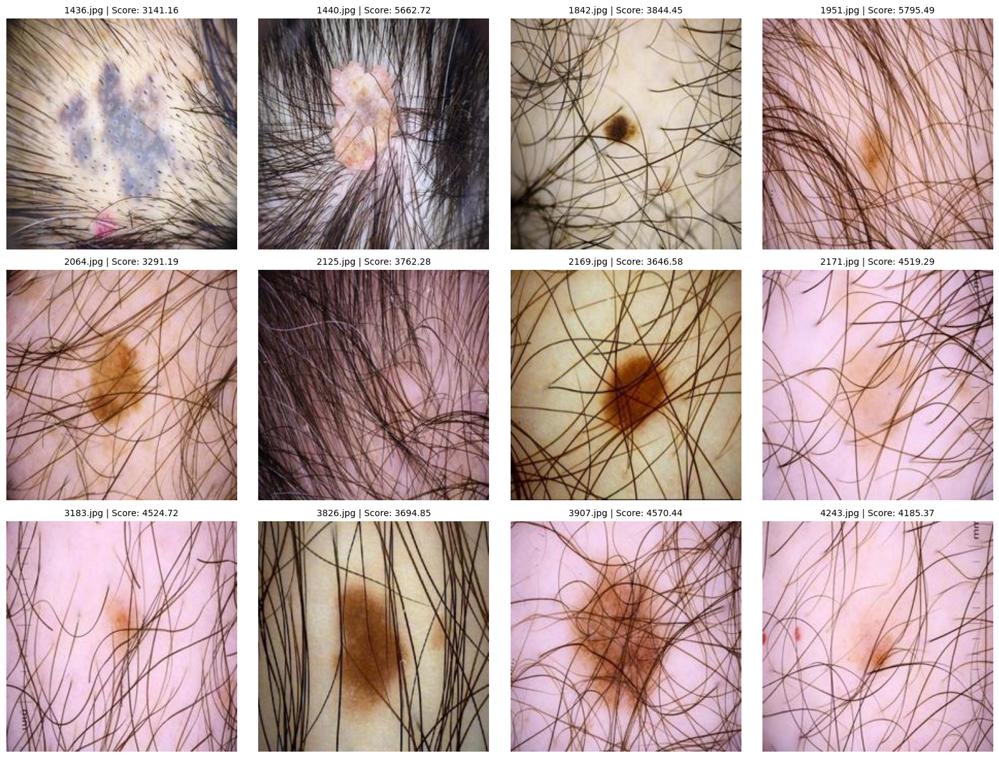

In [33]:
_, blurry_images_b2 = analyze_dataset(TRAIN_BENIGN, threshold=3000)
plot_images(blurry_images_b2, task="Benign type Sharp")

Total blurry images found: 22

 Found 22 Malignant type Sharp images, here are some samples:


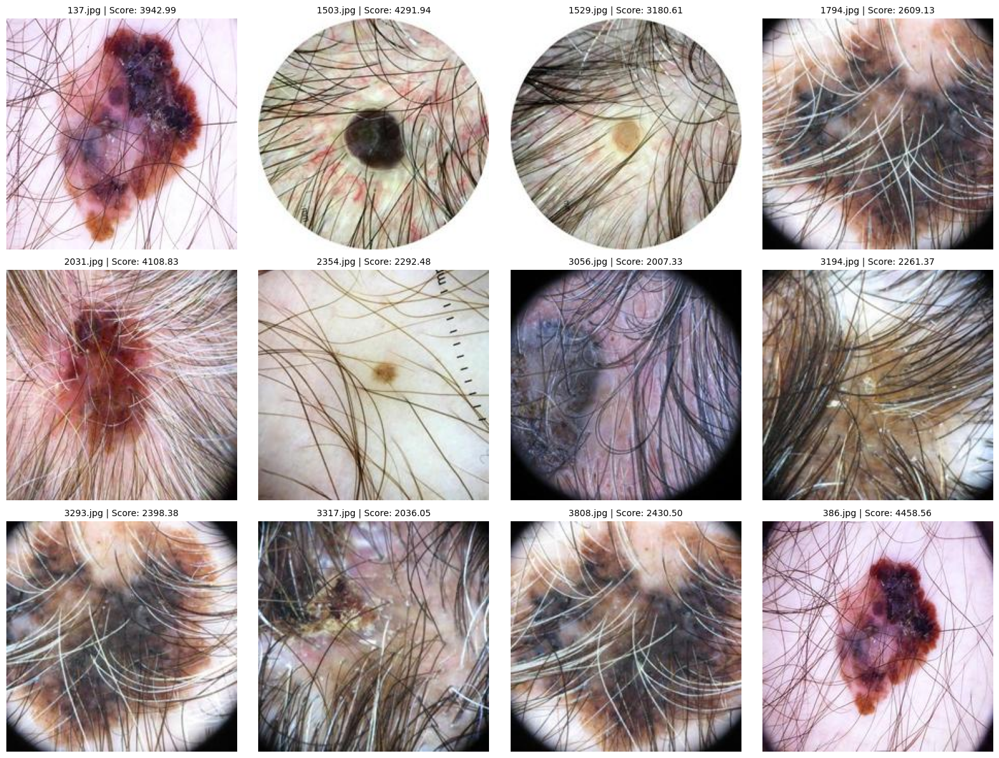

In [34]:
_, blurry_images_m2 = analyze_dataset(TRAIN_MALIGNANT, threshold=2000)
plot_images(blurry_images_m2, task="Malignant type Sharp")

##### Fix the outliers - removal of sharp images and addition of fixed images

In [51]:
def append_image_paths(image_list, all_paths):
    all_paths.extend([bp for bp, _ in image_list])

rem_benign_paths = []
append_image_paths(blurry_images_b1, rem_benign_paths)
append_image_paths(blurry_images_b2, rem_benign_paths)

rem_malignant_paths = []
append_image_paths(blurry_images_m1, rem_malignant_paths)
append_image_paths(blurry_images_m2, rem_malignant_paths)

In [56]:
def create_new_dataset(dataset, removal, addition):
    new_dataset = []

    for img_path in dataset.rglob("*.*"): 
        if img_path.suffix.lower() not in [".jpg", ".png", ".jpeg", ".bmp"]:
            continue  

        if img_path not in removal:
            new_dataset.append(img_path)

    if addition:
        for add_path in addition:
            new_dataset.append(add_path)

    return new_dataset

NEW_BENIGN_DATASET, NEW_MALIGNANT_DATASET = [], []
NEW_BENIGN_DATASET = create_new_dataset(TRAIN_BENIGN, rem_benign_paths, sharpened_b1)
NEW_MALIGNANT_DATASET = create_new_dataset(TRAIN_MALIGNANT, rem_malignant_paths, sharpened_m1)

train_class_counts['Benign'], len(NEW_BENIGN_DATASET), train_class_counts['Malignant'] , len(NEW_MALIGNANT_DATASET)

(6289, 6267, 5590, 5568)

#### Compute Dark Images

To detect dark images (low brightness), we can calculate the average brightness of an image and compare it to a predefined threshold. 

The brightness of an image can be computed by converting it to a grayscale image and calculating the mean pixel intensity. If the average brightness is below a certain threshold, the image can be classified as dark.

In [49]:
def compute_brightness(image_path):
    img = Image.open(image_path).convert("L")
    img_array = np.array(img)
    return img_array.mean()  


def analyze_low_brightness(dataset_path: list, threshold: int = 40):
    """
    Runs the brightness detection algorithm over a dataset directory.
    
    :param dataset_path: dataset list containing images.
    :param threshold: Brightness threshold.
    """
    brightness_scores = []
    dark_images = []

    for img_path in dataset_path: 
        if img_path.suffix.lower() not in [".jpg", ".png", ".jpeg", ".bmp"]:
            continue  

        brightness = compute_brightness(img_path)
        brightness_scores.append(brightness)

        if brightness < threshold:
            dark_images.append((img_path, brightness))

    print(f"Total dark images found: {len(dark_images)}")

    return brightness_scores, dark_images

Total dark images found: 7

 Found 7 Benign Class Brightness images, here are some samples:


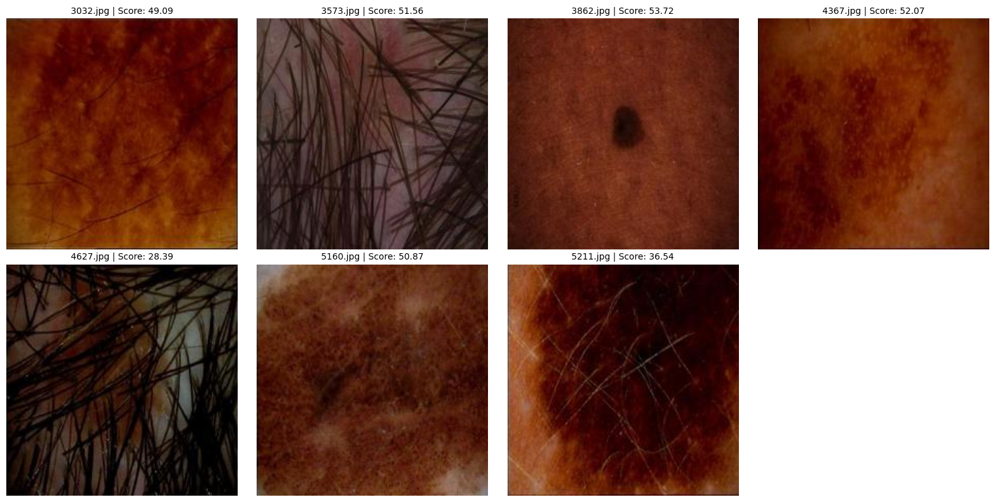

In [79]:
brightness_scores_b, dark_images_b1 = analyze_low_brightness(NEW_BENIGN_DATASET, threshold=55)
plot_images(dark_images_b1, task= "Benign Class Brightness")

Total dark images found: 16

 Found 16 Malignant Class Brightness images, here are some samples:


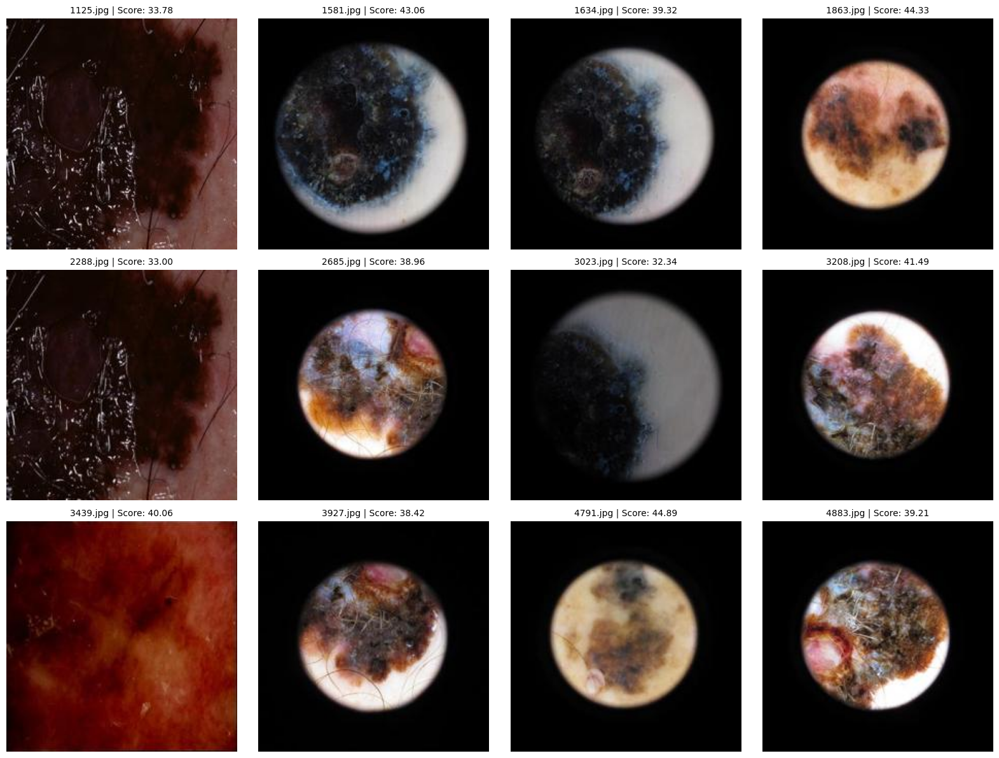

In [58]:
brightness_scores_m, dark_images_m1 = analyze_low_brightness(NEW_MALIGNANT_DATASET, threshold=45)
plot_images(dark_images_m1, task= "Malignant Class Brightness")

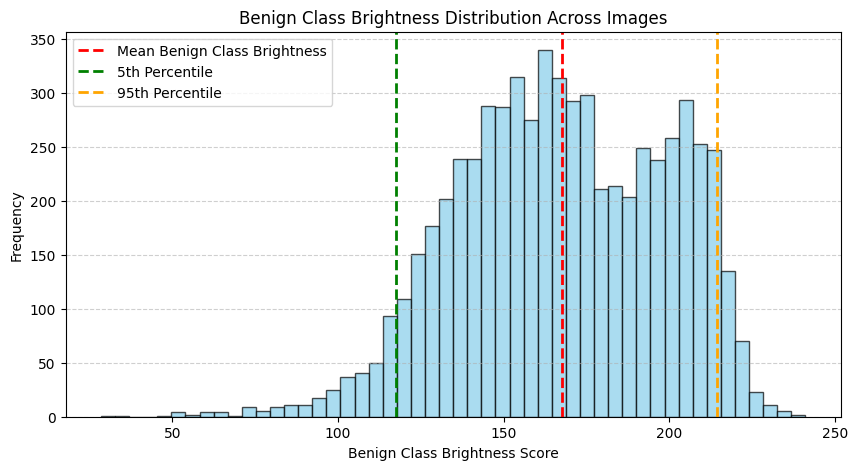

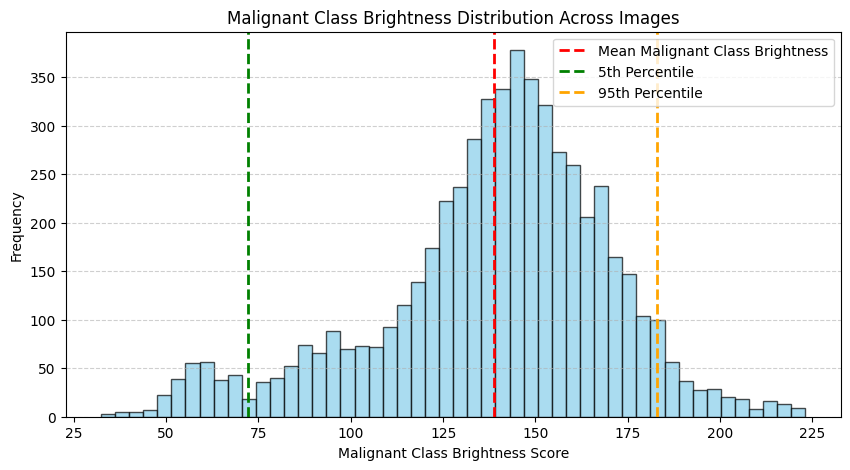

In [59]:
plot_hist(brightness_scores_b, bins=50, task = "Benign Class Brightness")
plot_hist(brightness_scores_m, bins=50, task = "Malignant Class Brightness")

##### Fix dark images - Adjust contrast

In [65]:
def adjust_clahe(img, clip_limit=2.0, tile_grid_size=(8, 8)):
    """Apply CLAHE (Contrast Limited Adaptive Histogram Equalization)."""
    img_lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(img_lab)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    l = clahe.apply(l)
    return cv2.cvtColor(cv2.merge((l, a, b)), cv2.COLOR_LAB2RGB)

def adjust_gamma(img, gamma=1.5):
    """Apply gamma correction to adjust brightness."""
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)], dtype=np.uint8)
    return cv2.LUT(img, table)

def contrast_stretching(img):
    """Apply linear contrast stretching."""
    min_val, max_val = np.min(img), np.max(img)
    return ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)

def process_dark_images(image_paths):
    """Apply preprocessing steps to a list of images.""" 

    fig, axes = plt.subplots(5, 4, figsize=(16, 20))
    fig.suptitle("Comparison of Brightening Techniques\n")

    for idx, (img_path,_) in enumerate(image_paths[:5]):  # Process only first 5 images for visualization
        img = cv2.imread(img_path)
        if img is None:
            print(f"Error reading {img_path}")
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
     
        # Apply different contrast and brightness adjustments
        clahe_img = adjust_clahe(img)
        gamma_corrected = adjust_gamma(img, gamma=1.5)
        contrast_stretched = contrast_stretching(img)

        # Plot the results
        axes[idx, 0].imshow(img)
        axes[idx, 0].set_title("Original Image")
        axes[idx, 0].axis("off")

        axes[idx, 1].imshow(clahe_img)
        axes[idx, 1].set_title("CLAHE")
        axes[idx, 1].axis("off")

        axes[idx, 2].imshow(gamma_corrected)
        axes[idx, 2].set_title("Gamma Correction")
        axes[idx, 2].axis("off")

        axes[idx, 3].imshow(contrast_stretched)
        axes[idx, 3].set_title("Contrast Stretching")
        axes[idx, 3].axis("off")
    
    plt.tight_layout()
    plt.show()


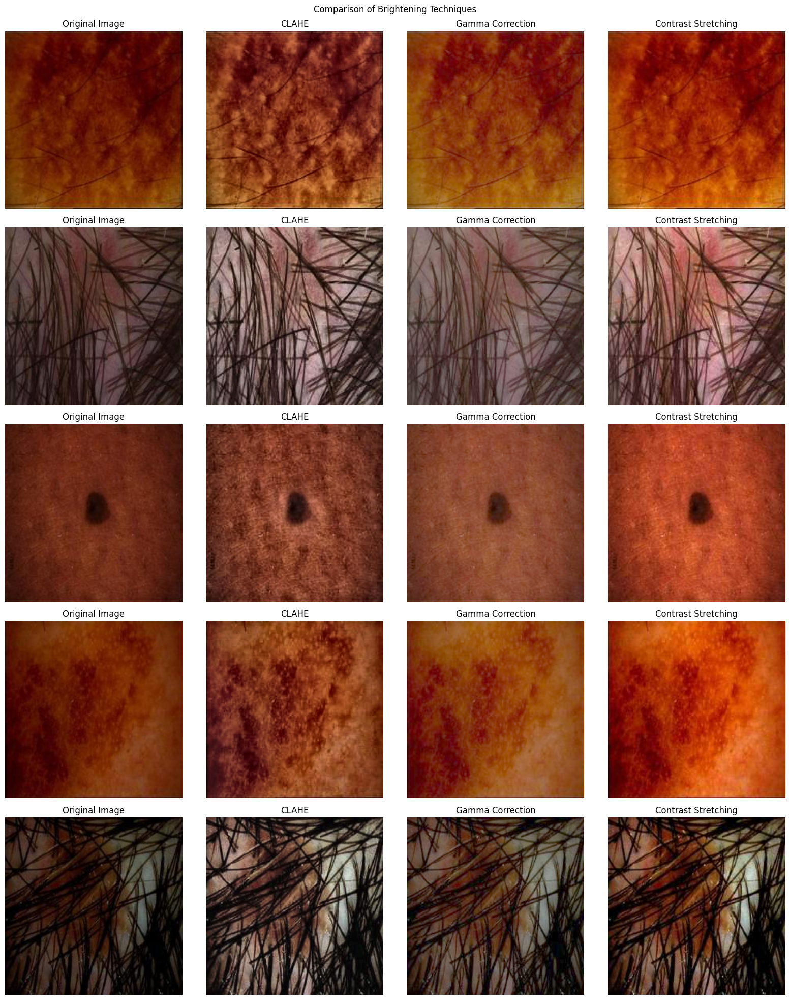

In [80]:
process_dark_images(dark_images_b1)

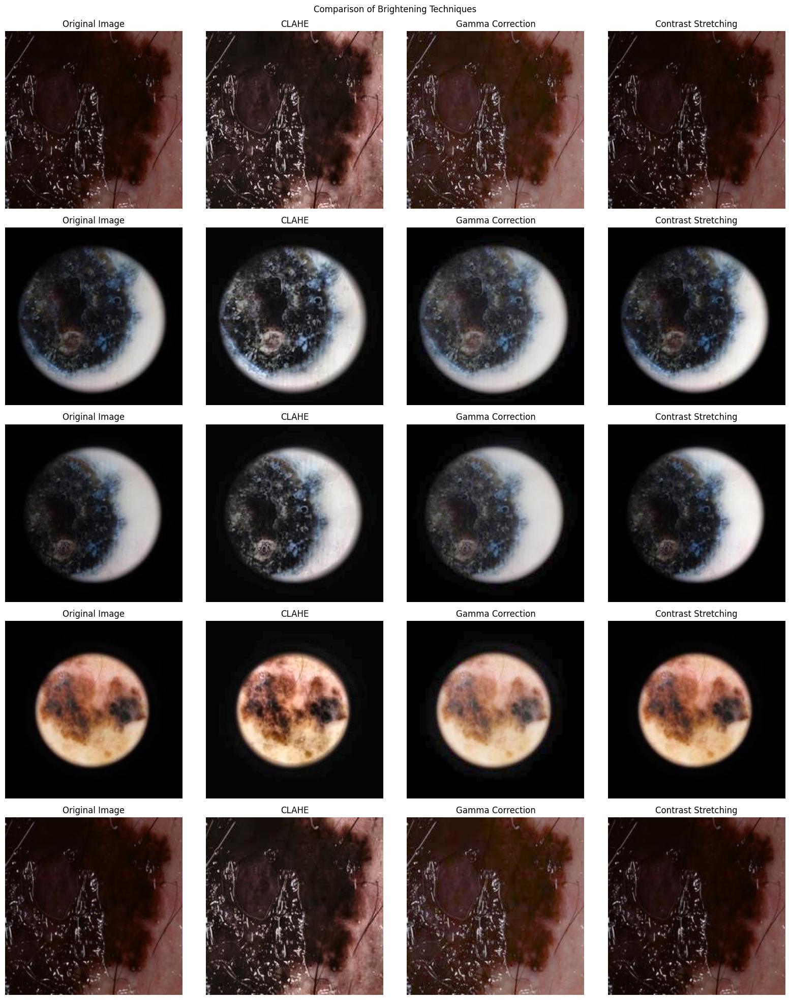

In [67]:
process_dark_images(dark_images_m1)

Applying CLAHE method on dark images

In [70]:
def apply_clahe_images(image_paths, output_folder):
    """Apply clahe steps to a list of images.""" 
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    bright_imgs = []

    for idx, (img_path,_) in enumerate(image_paths):  
        img = cv2.imread(img_path)
        # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
        brightened = adjust_clahe(img)

        outpath = output_folder / img_path.name
        cv2.imwrite(outpath, brightened)
        bright_imgs.append(outpath)

    return bright_imgs

In [84]:
bright_imgs_b = apply_clahe_images(dark_images_b1, TRAIN_DATASET / "brightened/Benign" )
bright_imgs_m = apply_clahe_images(dark_images_m1, TRAIN_DATASET / "brightened/Malignant" )

In [86]:
brightness_scores_c1, dark_images_c1 = analyze_low_brightness(bright_imgs_b, threshold=50)
brightness_scores_c2, dark_images_c2 = analyze_low_brightness(bright_imgs_m, threshold=45)

Total dark images found: 0
Total dark images found: 0


In [87]:
all_benign_paths_v2 = []
append_image_paths(dark_images_b1, all_benign_paths_v2)
all_benign_paths_v2.extend(rem_benign_paths)

all_malignant_paths_v2 = []
append_image_paths(dark_images_m1, all_malignant_paths_v2)
all_malignant_paths_v2.extend(rem_malignant_paths)

FINAL_BENIGN_DATASET, FINAL_MALIGNANT_DATASET = [], []

FINAL_BENIGN_DATASET = create_new_dataset(TRAIN_BENIGN, 
                                          all_benign_paths_v2, 
                                          bright_imgs_b)
FINAL_MALIGNANT_DATASET = create_new_dataset(TRAIN_MALIGNANT, 
                                             all_malignant_paths_v2, 
                                             bright_imgs_m)

train_class_counts['Benign'], len(FINAL_BENIGN_DATASET), train_class_counts['Malignant'], len(FINAL_MALIGNANT_DATASET)

(6289, 6250, 5590, 5545)

#### Dataset Distribution

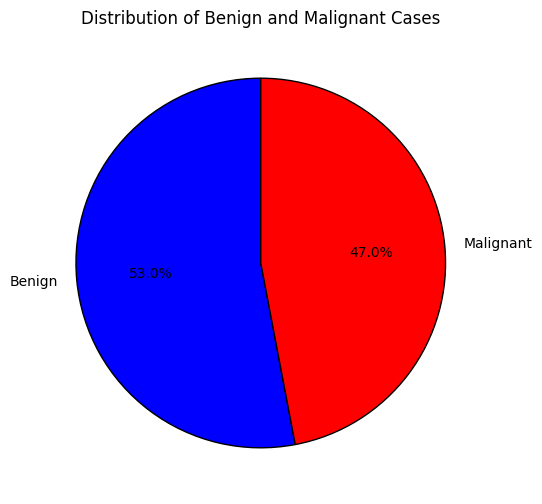

In [89]:
benign_count = len(FINAL_BENIGN_DATASET)
malignant_count = len(FINAL_MALIGNANT_DATASET)
total_samples = benign_count + malignant_count

# Calculate percentages
benign_percentage = (benign_count / total_samples) * 100
malignant_percentage = (malignant_count / total_samples) * 100

# Pie chart labels and sizes
labels = ['Benign', 'Malignant']
sizes = [benign_percentage, malignant_percentage]
colors = ['blue', 'red']

# Plot pie chart
plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=90, wedgeprops={'edgecolor': 'black'})
plt.title("Distribution of Benign and Malignant Cases")
plt.show()


In [90]:
TOTAL_TRAIN = FINAL_BENIGN_DATASET + FINAL_MALIGNANT_DATASET

### B. Apply Color Transformation

The idea it to standardize the input images and normalize their RGB values.

To normalize, we typically want to scale the pixel values to a standard range, between 0 and 1. This can help make the image data more consistent and easier to process for machine learning models, especially when they expect input data in a specific range.

In [10]:
def get_rgb_info(image_path):
    """ Compute the mean RGB values and normalize them with the grayscale mean. """
    image = cv2.imread(image_path)  # Load image
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = image.astype(np.float32) / 255.0  # Normalize to [0,1] range

    # Compute mean for each channel
    mean_r, mean_g, mean_b = np.mean(image, axis=(0, 1)) 

    # Compute grayscale mean
    gray_mean = np.mean([mean_r, mean_g, mean_b])

    # Normalize RGB values
    mean_r_norm = mean_r / gray_mean
    mean_g_norm = mean_g / gray_mean
    mean_b_norm = mean_b / gray_mean

    return [image_path, mean_r, mean_g, mean_b, mean_r_norm, mean_g_norm, mean_b_norm, gray_mean]

def process_rgb_images(image_paths):
    """ Process a list of image paths and return a DataFrame with color information. """
    # Apply the function to all image paths
    data = [get_rgb_info(path) for path in image_paths]

    # Create a DataFrame
    df = pd.DataFrame(data, columns=["Image_Path", "Red", "Green", "Blue", "Red_norm", "Green_norm", "Blue_norm", "Gray_mean"])
    return df

In [11]:
def plot_histograms(df_rgb):
    """ Plots histograms of mean RGB values and normalized RGB values. """
    sns.set_theme(style="whitegrid")

    # Create a figure with subplots (2 rows, 1 column)
    fig, axes = plt.subplots(2, 1, figsize=(12, 8))
    # Colors for RGB channels
    colors = {"Red": "red", "Green": "green", "Blue": "blue"}
    
    # Histogram for mean RGB values
    for color in colors:
        sns.histplot(df_rgb[f"{color}"], bins=30, kde=False, color=colors[color], alpha=0.5, ax=axes[0])
        sns.kdeplot(df_rgb[f"{color}"], color=colors[color], ax=axes[0], linewidth=2)
    axes[0].set_title("Histogram of RGB Mean Values")
    axes[0].set_xlabel("Mean Intensity")
    axes[0].set_ylabel("Frequency")
    axes[0].legend(["Red", "Green", "Blue"])

    # Histogram for normalized RGB values
    for color in colors:
        sns.histplot(df_rgb[f"{color}_norm"], bins=30, kde=False, color=colors[color], alpha=0.5, ax=axes[1])
        sns.kdeplot(df_rgb[f"{color}_norm"], color=colors[color], ax=axes[1], linewidth=2)  # Line plot
    axes[1].set_title("Histogram of Normalized RGB Values")
    axes[1].set_xlabel("Normalized Intensity")
    axes[1].set_ylabel("Frequency")
    axes[1].legend(["Red", "Green", "Blue"])

    # Adjust layout
    plt.tight_layout()
    plt.show()

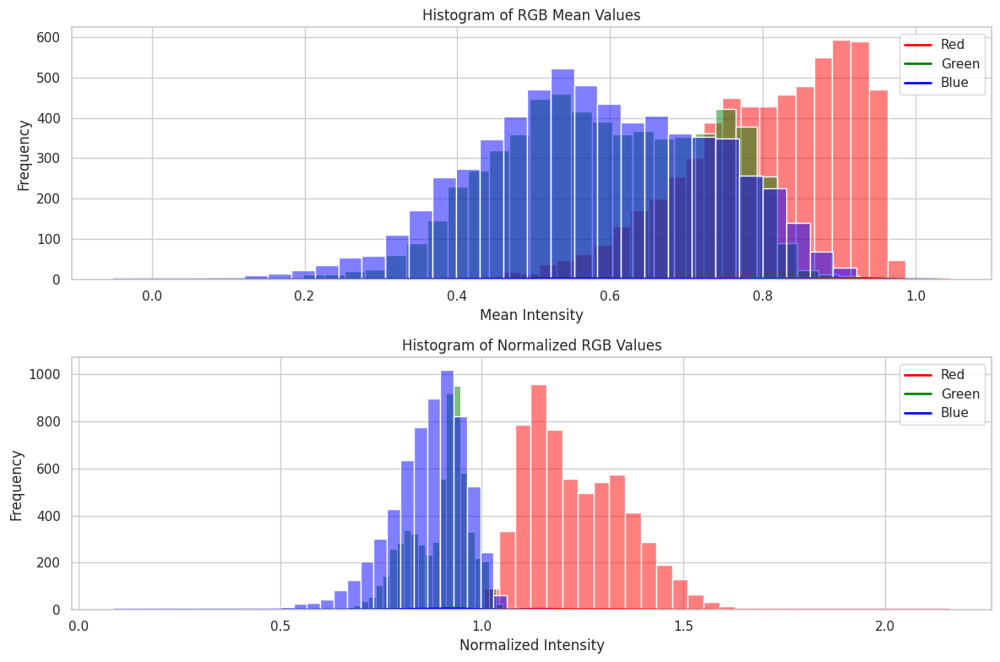

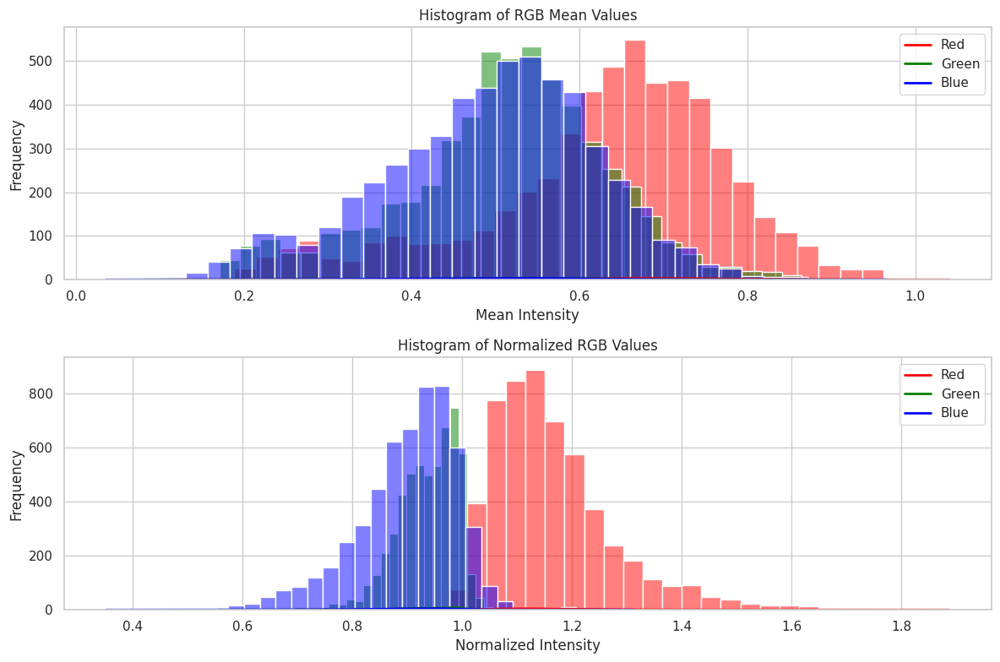

In [93]:
df_rgb_b = process_rgb_images(FINAL_BENIGN_DATASET)
plot_histograms(df_rgb_b)

df_rgb_m = process_rgb_images(FINAL_MALIGNANT_DATASET)
plot_histograms(df_rgb_m)

Normalized values reveal color dominance:

    - If Red_norm > 1, the image has a reddish tint.
    - If Blue_norm < 1, the image might have less blue dominance.
    - If all are close to 1, the image has neutral lighting.

Even if different images have varying brightness, the normalized RGB values stay consistent for similar lighting conditions.

In [16]:
def apply_color_correction(image_path, red_norm, green_norm, blue_norm):
    """ Applies color correction to an image using the normalized RGB values. """
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = image.astype(np.float32) / 255.0  # Normalize image (0-1)

    # Apply normalization correction
    image[:, :, 0] /= red_norm   # Red channel correction
    image[:, :, 1] /= green_norm # Green channel correction
    image[:, :, 2] /= blue_norm  # Blue channel correction

    # Clip values to [0, 1] range and rescale to [0, 255]
    image = np.clip(image, 0, 1) * 255
    image = image.astype(np.uint8)

    return image

def update_dataset(image_paths, df_rgb, output_folder):
    """ Updates dataset by applying color correction to all images. """

    for i, image_path in enumerate(image_paths):
        red_norm = df_rgb.loc[i, "Red_norm"]
        green_norm = df_rgb.loc[i, "Green_norm"]
        blue_norm = df_rgb.loc[i, "Blue_norm"]

        corrected_image = apply_color_correction(image_path, red_norm, green_norm, blue_norm)

        # Save the corrected image
        output_path = output_folder / str(image_path).split("/")[-1]  
        cv2.imwrite(output_path, cv2.cvtColor(corrected_image, cv2.COLOR_RGB2BGR))

    print(f"Corrected images saved in '{output_folder}'.")    

##### updating trainset

In [95]:
output_folder = TRAIN_DATASET/ "color_trans/Benign"
output_folder.mkdir(exist_ok=True, parents=True)  

# Apply the correction to all images
update_dataset(FINAL_BENIGN_DATASET, df_rgb_b, output_folder)

Corrected images saved in 'takehome/train/color_trans/Benign'.


In [96]:
output_folder = TRAIN_DATASET / "color_trans/Malignant"
output_folder.mkdir(exist_ok=True, parents=True)  

# Apply the correction to all images
update_dataset(FINAL_MALIGNANT_DATASET, df_rgb_m, output_folder)

Corrected images saved in 'takehome/train/color_trans/Malignant'.


##### updating testset

In [17]:
df_rgb_b_test = process_rgb_images(TEST_BENIGN.iterdir())
output_folder = TEST_DATASET / "color_trans/Benign"
output_folder.mkdir(exist_ok=True, parents=True)  

update_dataset(TEST_BENIGN.iterdir(), df_rgb_b_test, output_folder)

Corrected images saved in 'takehome/test/color_trans/Benign'.


In [18]:
df_rgb_m_test = process_rgb_images(TEST_MALIGNANT.iterdir())
output_folder = TEST_DATASET / "color_trans/Malignant"
output_folder.mkdir(exist_ok=True, parents=True)  

update_dataset(TEST_MALIGNANT.iterdir(), df_rgb_m_test, output_folder)

Corrected images saved in 'takehome/test/color_trans/Malignant'.


## 3. Model Building and Training

#### Custom DataLoader

The objective is to load the updated, color-transformed images and create a custom DataLoader that:

    - Converts each image to a tensor.
    - Normalizes the image using its mean and standard deviation.
    - Loads the corresponding label for each image.

This will ensure that the images are preprocessed correctly, making them ready for training in machine learning models. The DataLoader will handle batching, shuffling, and loading the data efficiently.

In [4]:
ben_path = Path("takehome/train/color_trans/Benign")
mal_path = Path("takehome/train/color_trans/Malignant")

FINAL_TOTAL_TRAIN = []
for file in ben_path.iterdir():
    FINAL_TOTAL_TRAIN.append(file)
for file in mal_path.iterdir():
    FINAL_TOTAL_TRAIN.append(file)

len(FINAL_TOTAL_TRAIN)

11795

In [5]:
ben_path_test = Path("takehome/test/color_trans/Benign")
mal_path_test = Path("takehome/test/color_trans/Malignant")

FINAL_TOTAL_TEST = []
for file in ben_path_test.iterdir():
    FINAL_TOTAL_TEST.append(file)
for file in mal_path_test.iterdir():
    FINAL_TOTAL_TEST.append(file)

len(FINAL_TOTAL_TEST)

2000

In [7]:
class ImagePathDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)
    
    def get_label_from_path(self, img_path):
        """Extracts label from folder name ('benign' → 0, 'malignant' → 1)."""
        folder_name = os.path.basename(os.path.dirname(img_path))  
        return 0 if folder_name.lower() == "benign" else 1 

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")  
        label = self.get_label_from_path(img_path)

        if self.transform:
            image = self.transform(image)

        return image, label


# Define transformations (resize, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),  
    transforms.ToTensor(),  
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  
])

# Create dataset and DataLoader
test_dataset = ImagePathDataset(FINAL_TOTAL_TEST, transform=transform)
test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=True, num_workers=4)

verify the count of labels for all images

In [27]:
from collections import Counter

def count_labels(dataloader):
    label_counts = Counter()
    
    for _, labels in dataloader:  
        label_counts.update(labels.tolist())  
    return label_counts

# Get label counts
label_counts = count_labels(test_dataloader)
label_counts

Counter({1: 1000, 0: 1000})

#### Choosing the Right Model 

In this task, we will evaluate several pre-trained CNN-based models to determine which performs best on the test set, and then train the most effective model. 

The models being considered are:

    - ResNet50: A deep residual network handles vanishing gradients
    - EfficientNet: A model designed to achieve high accuracy with fewer parameters
    - DenseNet121: A densely connected convolutional network 
    - MobileNetV2: A lightweight model optimized for mobile and edge devices
    - InceptionV3: A model known for its efficiency in terms of computation and accuracy

We will evaluate these models on the test set, compare their performance, and then proceed to train the model that delivers the best results.

In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
batch_size = 32
image_size = 224 
num_classes = 2  

In [41]:
# Load pre-trained models
models_dict = {
    "ResNet50": models.resnet50(pretrained=True),
    "EfficientNet": models.efficientnet_b0(pretrained=True),
    "DenseNet121": models.densenet121(pretrained=True),
    "MobileNetV2": models.mobilenet_v2(pretrained=True),
    "InceptionV3": models.inception_v3(pretrained=True),
}

# Modify final layer for binary classification (2 classes)
for model_name, model in models_dict.items():
    if model_name == "InceptionV3":
        model.AuxLogits.fc = nn.Linear(model.AuxLogits.fc.in_features, num_classes)  # Inception has an auxiliary classifier
        model.fc = nn.Linear(model.fc.in_features, num_classes)
    
    elif model_name == "EfficientNet" or model_name == "MobileNetV2":
        model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)  # MobileNet and EfficientNet uses classifier
    
    elif model_name == "DenseNet121":
        model.classifier = nn.Linear(model.classifier.in_features, num_classes)  # DenseNet uses classifier
    
    else:  # ResNet models
        model.fc = nn.Linear(model.fc.in_features, num_classes)

    model = model.to(device)
    model.eval() 

In [42]:
def evaluate_model(model, test_loader):
    all_preds = []
    all_labels = []
    all_probs = []
    total_correct = 0
    total_samples = 0
    total_loss = 0
    criterion = nn.CrossEntropyLoss()

    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc="Evaluating"):
            images, labels = images.to(device), labels.to(device)
            
            # Forward pass
            outputs = model(images)
            
            # Convert logits to probabilities
            probs = torch.softmax(outputs, dim=1)  
            _, preds = torch.max(outputs, 1)
            
            loss = criterion(outputs, labels)
            
            # Collecting predictions and labels
            all_probs.extend(probs[:, 1].cpu().numpy()) 
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

            # Calculate accuracy
            total_correct += (preds == labels).sum().item()
            total_samples += labels.size(0)
            total_loss += loss.item()

    accuracy = 100 * total_correct / total_samples
    avg_loss = total_loss / len(test_loader)
    cm = confusion_matrix(all_labels, all_preds)

    return accuracy, avg_loss, cm, np.array(all_probs), np.array(all_labels), np.array(all_preds)

In [105]:
for model_name, model in models_dict.items():
    # Test all models and display results
    print(f"\nEvaluating {model_name}...")
    start_time = time.time()
    accuracy, avg_loss, cm, y_probs, y_true, y_pred = evaluate_model(model, test_dataloader)
    end_time = time.time()

    print(f"{model_name} - Accuracy: {accuracy:.2f}% | Avg Loss: {avg_loss:.4f}")
    print(f"Time taken for {model_name}: {end_time - start_time:.2f} seconds\n")


Evaluating ResNet50...


Evaluating: 100%|██████████| 63/63 [00:09<00:00,  6.70it/s]


ResNet50 - Accuracy: 58.05% | Avg Loss: 0.6744
Time taken for ResNet50: 9.42 seconds


Evaluating EfficientNet...


Evaluating: 100%|██████████| 63/63 [00:04<00:00, 14.42it/s]


EfficientNet - Accuracy: 52.55% | Avg Loss: 0.6917
Time taken for EfficientNet: 4.37 seconds


Evaluating DenseNet121...


Evaluating: 100%|██████████| 63/63 [00:06<00:00, 10.26it/s]


DenseNet121 - Accuracy: 58.50% | Avg Loss: 0.6884
Time taken for DenseNet121: 6.14 seconds


Evaluating MobileNetV2...


Evaluating: 100%|██████████| 63/63 [00:02<00:00, 25.23it/s]


MobileNetV2 - Accuracy: 49.60% | Avg Loss: 0.7256
Time taken for MobileNetV2: 2.50 seconds


Evaluating InceptionV3...


Evaluating: 100%|██████████| 63/63 [00:04<00:00, 13.22it/s]

InceptionV3 - Accuracy: 48.60% | Avg Loss: 0.7100
Time taken for InceptionV3: 4.77 seconds



#### Fine-tuning Top 2 Performing models - ResNet50 and DenseNet121

1. Split the Training Set: Divide the training dataset into training and validation sets
2. Setup Loss and Optimizer Functions: Cross Entropy loss and Adam/ SGD optimizer (depends on the model)
3. Define the Training Function: 
    
    - Makes predictions on a batch of images.
    - Calculates the loss and accuracy.
    - Evaluates the model on the validation set without updating the gradients or model weights.


In [10]:
train_paths, val_paths = train_test_split(FINAL_TOTAL_TRAIN, test_size=0.3, random_state=42)
len(train_paths), len(val_paths)

(8256, 3539)

In [11]:
# Loss function
criterion = nn.CrossEntropyLoss()

# Load dataset
train_dataset = ImagePathDataset(train_paths, transform=transform)
val_dataset = ImagePathDataset(val_paths, transform=transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)

In [ ]:
def train_model(model, optimizer, train_loader, val_loader, checkpoint_path, num_epochs):
    model.train()
    train_losses, val_losses = [], []
    train_accuracies, val_accuracies  = [], []

    best_val_loss = float('inf')
    best_model_wts = None

    for epoch in range(num_epochs):
        running_train_loss = 0.0
        correct_train, total_train = 0, 0
        
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(images)
            
            loss = criterion(outputs, labels)
            
            loss.backward()
            optimizer.step()
            
            running_train_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)

        train_loss = running_train_loss / len(train_loader)
        train_acc = correct_train / total_train * 100
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        # Validation phase
        model.eval()  
        running_val_loss = 0.0
        correct_val, total_val = 0, 0

        with torch.no_grad():  
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                
                outputs = model(images)  
                
                loss = criterion(outputs, labels)  
                running_val_loss += loss.item()
                _, predicted = torch.max(outputs, 1)  
                correct_val += (predicted == labels).sum().item()  
                total_val += labels.size(0)
        
        # Calculate validation loss and accuracy for the epoch
        val_loss = running_val_loss / len(val_loader)
        val_acc = correct_val / total_val * 100
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)

        # Print results for the epoch
        print(f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Train Accuracy: {train_acc:.2f}%")
        print(f"Epoch {epoch+1}/{num_epochs} - Val Loss: {val_loss:.4f}, Val Accuracy: {val_acc:.2f}%")

        # Save model checkpoint if validation loss improves
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model_wts = model.state_dict()  
            torch.save(model.state_dict(), checkpoint_path)  

    # Load best model weights
    if best_model_wts is not None:
        model.load_state_dict(best_model_wts)
    
    return train_losses, val_losses, train_accuracies, val_accuracies

#### ResNet50 Model - Custom Classifier

In this custom ResNet50 classifier, the original classification block is modified to include additional fully connected layers, activation functions, and dropout for better generalization and performance. 

Here’s a breakdown of the changes made:

1. Linear Layer (in_features=2048, out_features=1024): The first fully connected layer

2. ReLU Activation: After the first linear layer, a ReLU activation function is applied to introduce non-linearity 

3. Dropout (p=0.6): A dropout layer is introduced with a probability of 0.6 to prevent overfitting 

4. Linear Layer (in_features=1024, out_features=512): The second fully connected layer 

5. ReLU Activation: Another ReLU activation function is applied

6. Dropout (p=0.6): A second dropout layer is added with the same probability 

7. Linear Layer (in_features=512, out_features=2): The final linear layer has 2 output units, which is the number of classes 

Summary of Changes:

    - Two additional linear layers were added after the original ResNet50 classification block, reducing the features progressively from 2048 to 1024, then to 512.

    - ReLU activation functions were added after each of the linear layers to introduce non-linearity.
    
    - Dropout layers with a probability of 0.6 were included after each ReLU activation to reduce overfitting and improve the generalization of the model.

In [13]:
class ResNetModel(nn.Module):
    def __init__(self, num_classes):
        super(ResNetModel, self).__init__()
        self.resnet = models.resnet50(pretrained=True)
        
        # Extract all layers except the final fully connected layer
        self.features = nn.Sequential(*list(self.resnet.children())[:-2])
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.classifier = nn.Sequential(
            nn.Linear(2048, 1024),  
            nn.ReLU(), 
            nn.Dropout(0.6), 
            nn.Linear(1024, 512),  
            nn.ReLU(), 
            nn.Dropout(0.6), 
            nn.Linear(512, num_classes), 
        )
      
    def forward(self, x):
        x = self.features(x)  
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  
        x = self.classifier(x)  
        return x

# Instantiate the model
resnetmodel = ResNetModel(num_classes)
resnetmodel = resnetmodel.to(device)
print(resnetmodel.classifier)

Sequential(
  (0): Linear(in_features=2048, out_features=1024, bias=True)
  (1): ReLU()
  (2): Dropout(p=0.6, inplace=False)
  (3): Linear(in_features=1024, out_features=512, bias=True)
  (4): ReLU()
  (5): Dropout(p=0.6, inplace=False)
  (6): Linear(in_features=512, out_features=2, bias=True)
)


In [ ]:
# utility functions
def plot_curves(train_curves, val_curves):
    plt.figure(figsize=(10, 5))
    plt.plot(train_curves[0], label='Training Loss')
    plt.plot(val_curves[0], label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'{model_name} - Training and Validation Loss')
    plt.legend()
    plt.show()

    # Plot training and validation accuracy
    plt.figure(figsize=(10, 5))
    plt.plot(train_curves[1], label='Training Accuracy')
    plt.plot(val_curves[1], label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.title(f'{model_name} - Training and Validation Accuracy')
    plt.legend()
    plt.show()

def calc_metrics(cm):
    _, FP, FN, TP = cm.ravel()   

    precision = TP / (TP + FP) if (TP + FP) > 0 else 0
    recall = TP / (TP + FN) if (TP + FN) > 0 else 0
    
    print(f"FP (Misclassify) = {FP}, FN (Missed) = {FN}")
    print(f"Precision: {precision * 100:.2f}")
    print(f"Recall: {recall * 100:.2f}")

def plot_roc_curve(y_true, y_probs):
    fpr, tpr, thresholds = roc_curve(y_true, y_probs)
    roc_auc = auc(fpr, tpr)

    # Plot ROC Curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Diagonal baseline
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve for Skin Cancer Classification')
    plt.legend(loc="lower right")
    plt.grid()
    plt.show()

    

##### a. Trial 1 - Adam Optimizer

In this trial, we used the Adam optimizer to train the custom ResNet50 classifier. 
However, it was observed that the model did not train well with Adam, as seen from the accuracy and loss curves. 

Specifically, the training process was unstable, with significant fluctuations in both accuracy and loss, which suggests that the optimizer was unable to converge effectively.

In [ ]:
# Fine-tune models
model_name = resnetmodel._get_name()
print(f"\nTraining Custom {model_name}...\n")

for module in resnetmodel.modules():
    if isinstance(module, nn.BatchNorm2d):
        module.train()

optimizer = optim.Adam(resnetmodel.parameters(), lr=0.001, amsgrad=True)

checkpoint_path = f"models/{model_name}_Mar7_best_model.pth"
train_losses, val_losses, train_accuracies, val_accuracies = train_model(resnetmodel, optimizer,
                                                                         train_loader, val_loader, 
                                                                         checkpoint_path, num_epochs=5)


Training Custom ResNetModel...

Epoch 1/5 - Train Loss: 0.4269, Train Accuracy: 80.75%
Epoch 1/5 - Val Loss: 0.5067, Val Accuracy: 73.01%
Epoch 2/5 - Train Loss: 0.7087, Train Accuracy: 52.63%
Epoch 2/5 - Val Loss: 0.6916, Val Accuracy: 53.04%
Epoch 3/5 - Train Loss: 0.6912, Train Accuracy: 52.93%
Epoch 3/5 - Val Loss: 0.6896, Val Accuracy: 49.90%
Epoch 4/5 - Train Loss: 0.5292, Train Accuracy: 72.18%
Epoch 4/5 - Val Loss: 0.5043, Val Accuracy: 71.60%
Epoch 5/5 - Train Loss: 0.4340, Train Accuracy: 79.02%
Epoch 5/5 - Val Loss: 0.4266, Val Accuracy: 79.80%


In [ ]:
print(f"\nEvaluating {resnetmodel._get_name()}...")

checkpoint_path = "models/ResNetModel_Mar7_best_model.pth"
checkpoint = torch.load(checkpoint_path)
resnetmodel = ResNetModel(num_classes=2)

resnetmodel.load_state_dict(checkpoint)

resnetmodel.to(device)
start_time = time.time()
accuracy, avg_loss, cm, y_probs, y_true, y_pred = evaluate_model(resnetmodel, test_dataloader)
end_time = time.time()

print(f"{resnetmodel._get_name()} - Accuracy: {accuracy:.2f}% | Avg Loss: {avg_loss:.4f}")
print(f"Time taken for {resnetmodel._get_name()}: {end_time - start_time:.2f} seconds\n")


Evaluating ResNetModel...


Evaluating: 100%|██████████| 63/63 [00:03<00:00, 16.15it/s] 

ResNetModel - Accuracy: 52.20% | Avg Loss: 0.9361
Time taken for ResNetModel: 3.91 seconds



In [103]:
calc_metrics(cm)

FP (Misclassify) = 182, FN (Missed) = 774
Precision: 55.39
Recall: 22.60


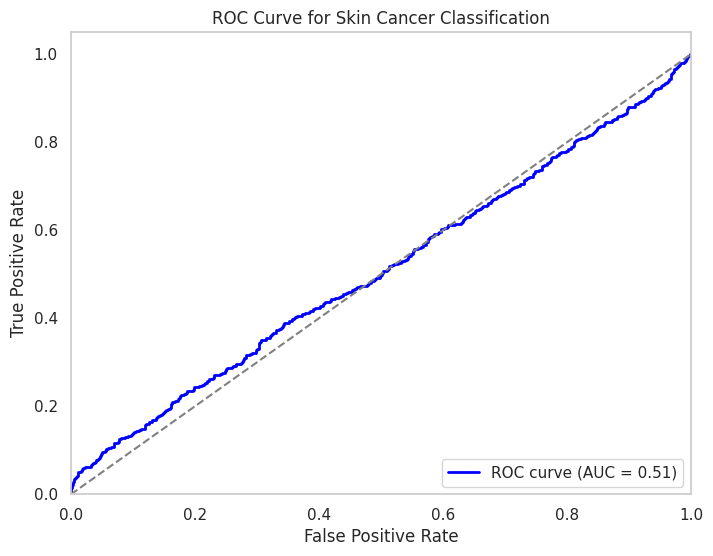

In [104]:
plot_roc_curve(y_true, y_probs)

Post-processing : Adjust threshold depending on the use case - Low False alarms or Low Misses

In [113]:
optimal_threshold = 0.2  # Lower threshold for higher recall
y_preds_adjusted = (y_probs >= optimal_threshold).astype(int)

newcm= confusion_matrix(y_true, y_preds_adjusted)
calc_metrics(newcm)

FP (Misclassify) = 715, FN (Missed) = 302
Precision: 49.40
Recall: 69.80


##### b. Trial 2 - SGD Optimizer

In this trial, we switched to using the Stochastic Gradient Descent (SGD) optimizer, which significantly improved the model's performance. 

With this optimizer, the model was able to achieve an impressive ROC (Receiver Operating Characteristic) score of 0.97, indicating excellent classification performance

In [15]:
# Fine-tune models
model_name = resnetmodel._get_name()
print(f"\nTraining Custom {model_name}...\n")

for module in resnetmodel.modules():
    if isinstance(module, nn.BatchNorm2d):
        module.train()

optimizer = torch.optim.SGD(resnetmodel.parameters(), lr=0.001, momentum=0.9, weight_decay=1e-4)

checkpoint_path = f"{model_name}_Mar7_SGD_best_model.pth"
train_losses, val_losses, train_accuracies, val_accuracies = train_model(resnetmodel, optimizer,
                                                                         train_loader, val_loader, 
                                                                         checkpoint_path, num_epochs=5)


Training Custom ResNetModel...

Epoch 1/5 - Train Loss: 0.4789, Train Accuracy: 76.97%
Epoch 1/5 - Val Loss: 0.2935, Val Accuracy: 87.48%
Epoch 2/5 - Train Loss: 0.3026, Train Accuracy: 87.05%
Epoch 2/5 - Val Loss: 0.2661, Val Accuracy: 88.44%
Epoch 3/5 - Train Loss: 0.2490, Train Accuracy: 89.27%
Epoch 3/5 - Val Loss: 0.2437, Val Accuracy: 89.12%
Epoch 4/5 - Train Loss: 0.2150, Train Accuracy: 90.69%
Epoch 4/5 - Val Loss: 0.2387, Val Accuracy: 90.00%
Epoch 5/5 - Train Loss: 0.1777, Train Accuracy: 92.60%
Epoch 5/5 - Val Loss: 0.2328, Val Accuracy: 89.60%


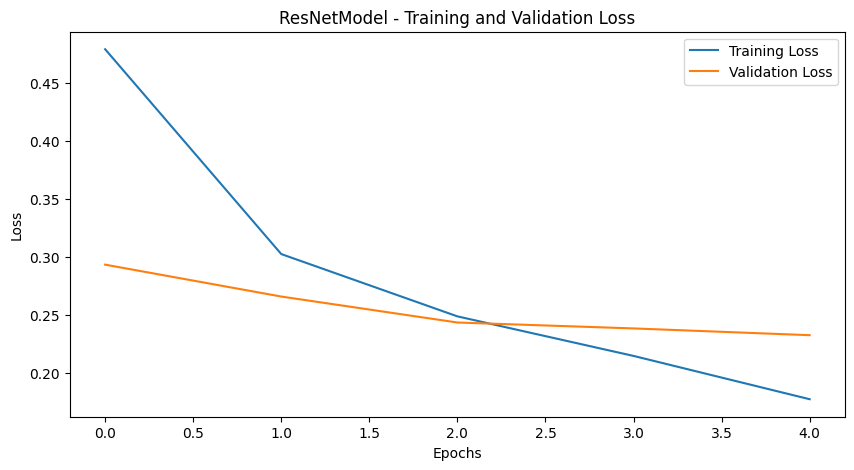

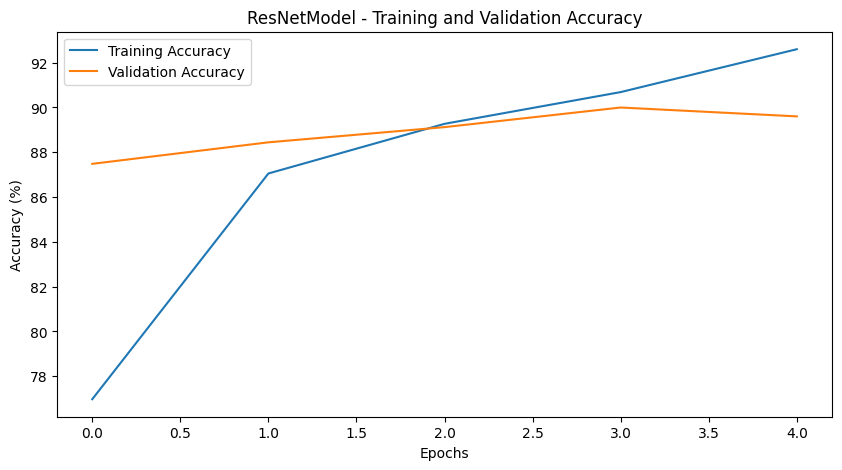

In [17]:
plot_curves([train_losses, train_accuracies], 
            [val_losses, val_accuracies])


Evaluating ResNetModel...


Evaluating: 100%|██████████| 63/63 [00:03<00:00, 15.87it/s]

ResNetModel - Accuracy: 90.35% | Avg Loss: 0.2535
Time taken for ResNetModel: 3.98 seconds



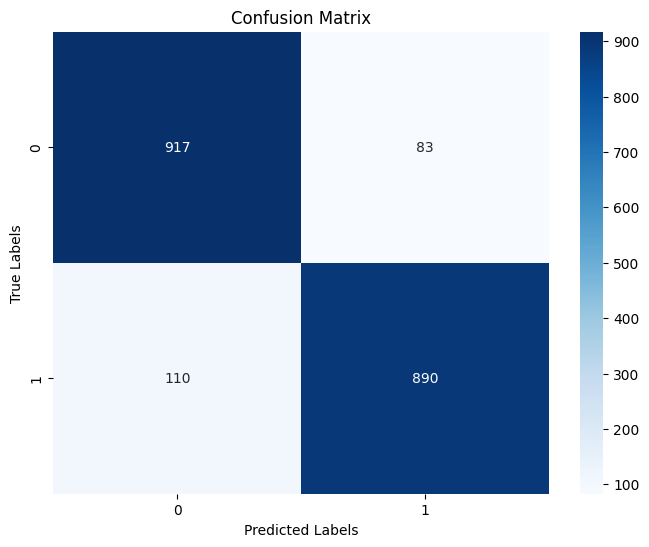

In [29]:
print(f"\nEvaluating {resnetmodel._get_name()}...")

checkpoint_path = "ResNetModel_Mar7_SGD_best_model.pth"
checkpoint = torch.load(checkpoint_path)
resnetmodel = ResNetModel(num_classes=2)

resnetmodel.load_state_dict(checkpoint)

resnetmodel.to(device)
start_time = time.time()
accuracy, avg_loss, cm, y_probs, y_true, y_pred = evaluate_model(resnetmodel, test_dataloader)
end_time = time.time()

print(f"{resnetmodel._get_name()} - Accuracy: {accuracy:.2f}% | Avg Loss: {avg_loss:.4f}")
print(f"Time taken for {resnetmodel._get_name()}: {end_time - start_time:.2f} seconds\n")

# Plot confusion matrix using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=True, yticklabels=True)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [32]:
calc_metrics(cm), f1_score(y_true, y_pred)

FP (Misclassify) = 83, FN (Missed) = 110
Precision: 91.47
Recall: 89.00


(None, 0.9021794221996959)

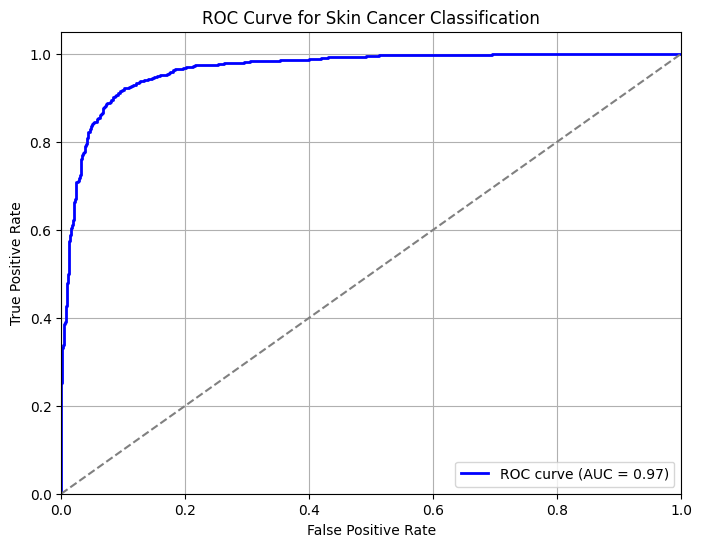

In [23]:
plot_roc_curve(y_true, y_probs)

Post-processing : Adjust threshold depending on the use case - Low False alarms or Low Misses

In [33]:
optimal_threshold = 0.3  # Lower threshold for higher recall
y_preds_adjusted = (y_probs >= optimal_threshold).astype(int)

newcm= confusion_matrix(y_true, y_preds_adjusted)
calc_metrics(newcm), f1_score(y_true, y_preds_adjusted)

FP (Misclassify) = 146, FN (Missed) = 58
Precision: 86.58
Recall: 94.20


(None, 0.9022988505747126)

#### DenseNet121 Model - Custom Classifier

In this custom DenseNet121 classifier, the original classification block is modified to include fully connected layers, activation functions, and dropout for improved performance and generalization. 

Here's a breakdown of the changes made:

1. Linear Layer (in_features=1024, out_features=512): The first fully connected layer takes the output from the DenseNet121 backbone (1024 features) and reduces it to 512 features.

2. ReLU Activation: After the first linear layer, a ReLU activation function is applied to introduce non-linearity.

3. Dropout (p=0.5): A dropout layer with a probability of 0.5 is included

4. Linear Layer (in_features=512, out_features=2): The second fully connected layer further reduces the number of features from 512 to 2.

5. Softmax Activation (dim=1): A Softmax activation is applied at the output layer to convert the logits into probabilities. 

Summary of Changes:
    
    - The original DenseNet121 classifier block was modified by adding two fully connected layers: one reducing from 1024 to 512 features, and the second reducing from 512 to 2 features.
    
    - ReLU activation was added after the first linear layer to introduce non-linearity.
    
    - Dropout with a probability of 0.5 was added to reduce overfitting.
    
    - The final output layer uses Softmax to produce class probabilities, which is typical for classification tasks.

In [45]:
class DenseNetModel(nn.Module):
    def __init__(self, num_classes):
        super(DenseNetModel, self).__init__()
        self.densenet = models.densenet121(pretrained=True)
        
        # Modify the classifier part (last fully connected layer)
        # Remove the original classifier of the pre-trained model
        self.features = self.densenet.features
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.classifier = nn.Sequential(
            nn.Linear(self.densenet.classifier.in_features, 512),  
            nn.ReLU(), 
            nn.Dropout(0.5), 
            nn.Linear(512, num_classes), 
            nn.Softmax(dim=1)  
        )

    def forward(self, x):
        x = self.features(x)  
        x = self.avgpool(x)
        x = torch.flatten(x, 1)  
        x = self.classifier(x)  
        return x

# Instantiate the model
densemodel = DenseNetModel(num_classes)
densemodel = densemodel.to(device)
print(densemodel.classifier)

Sequential(
  (0): Linear(in_features=1024, out_features=512, bias=True)
  (1): ReLU()
  (2): Dropout(p=0.5, inplace=False)
  (3): Linear(in_features=512, out_features=2, bias=True)
  (4): Softmax(dim=1)
)


In [112]:
# Fine-tune models
model_name = densemodel._get_name()
print(f"\nTraining Custom {model_name}...\n")

optimizer = optim.Adam(densemodel.parameters(), lr=0.0001, betas=(0.9, 0.999), eps=1e-8, amsgrad=True)

checkpoint_path = f"{model_name}_Mar7_best_model.pth"
train_losses, val_losses, train_accuracies, val_accuracies = train_model(densemodel, optimizer,
                                                                         train_loader, val_loader, 
                                                                         checkpoint_path, num_epochs=10)


Training Custom DenseNetModel...

Epoch 1/10 - Train Loss: 0.4440, Train Accuracy: 86.77%
Epoch 1/10 - Val Loss: 0.4169, Val Accuracy: 89.15%
Epoch 2/10 - Train Loss: 0.4599, Train Accuracy: 84.67%
Epoch 2/10 - Val Loss: 0.4254, Val Accuracy: 88.33%
Epoch 3/10 - Train Loss: 0.4316, Train Accuracy: 87.78%
Epoch 3/10 - Val Loss: 0.4445, Val Accuracy: 86.27%
Epoch 4/10 - Train Loss: 0.4114, Train Accuracy: 89.84%
Epoch 4/10 - Val Loss: 0.4141, Val Accuracy: 89.46%
Epoch 5/10 - Train Loss: 0.4119, Train Accuracy: 89.77%
Epoch 5/10 - Val Loss: 0.4363, Val Accuracy: 87.26%
Epoch 6/10 - Train Loss: 0.4051, Train Accuracy: 90.36%
Epoch 6/10 - Val Loss: 0.4227, Val Accuracy: 88.64%
Epoch 7/10 - Train Loss: 0.4007, Train Accuracy: 90.95%
Epoch 7/10 - Val Loss: 0.4240, Val Accuracy: 88.70%
Epoch 8/10 - Train Loss: 0.3954, Train Accuracy: 91.64%
Epoch 8/10 - Val Loss: 0.4240, Val Accuracy: 88.50%
Epoch 9/10 - Train Loss: 0.3976, Train Accuracy: 91.27%
Epoch 9/10 - Val Loss: 0.4169, Val Accuracy: 

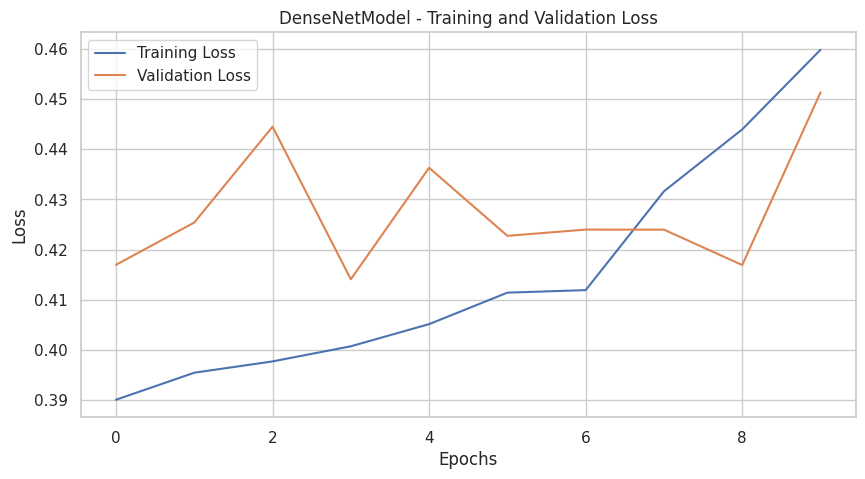

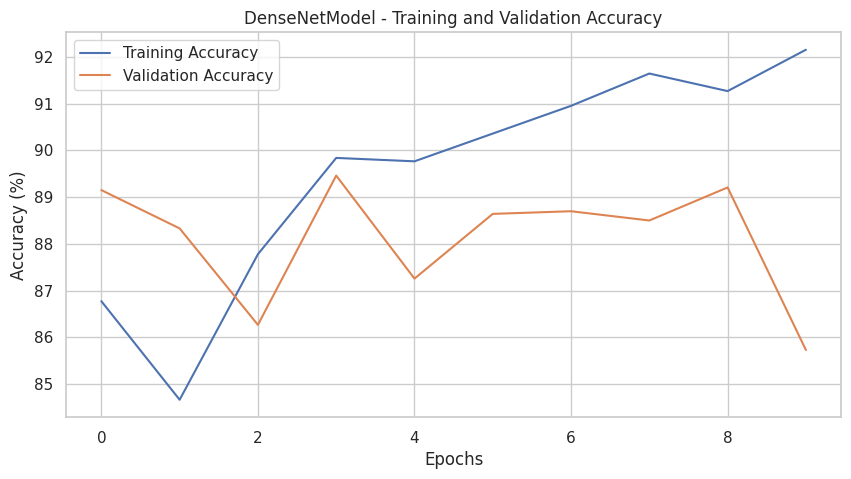

In [115]:
plot_curves([train_losses, train_accuracies], 
            [val_losses, val_accuracies])


Evaluating DenseNetModel...


Evaluating: 100%|██████████| 63/63 [00:06<00:00,  9.44it/s]


DenseNetModel - Accuracy: 92.65% | Avg Loss: 0.3839
Time taken for DenseNetModel: 6.68 seconds



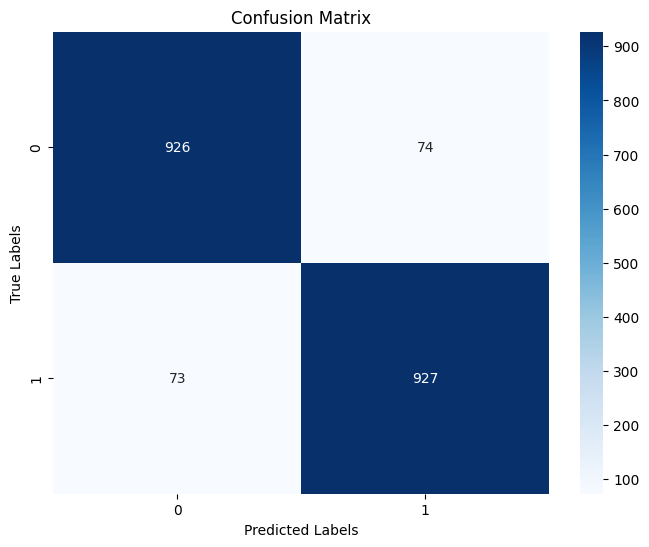

In [48]:
model_name = densemodel._get_name()
checkpoint_path = f"models/{model_name}_Mar7_best_model.pth"

print(f"\nEvaluating {model_name}...")
checkpoint = torch.load(checkpoint_path)
densemodel = DenseNetModel(num_classes=2)

densemodel.load_state_dict(checkpoint)

densemodel.to(device)
start_time = time.time()
accuracy, avg_loss, cm, y_probs, y_true, y_pred = evaluate_model(densemodel, test_dataloader)
end_time = time.time()

print(f"{model_name} - Accuracy: {accuracy:.2f}% | Avg Loss: {avg_loss:.4f}")
print(f"Time taken for {model_name}: {end_time - start_time:.2f} seconds\n")

# Plot confusion matrix using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=True, yticklabels=True)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [49]:
calc_metrics(cm), f1_score(y_true, y_pred)

FP (Misclassify) = 74, FN (Missed) = 73
Precision: 92.61
Recall: 92.70


(None, 0.9265367316341829)

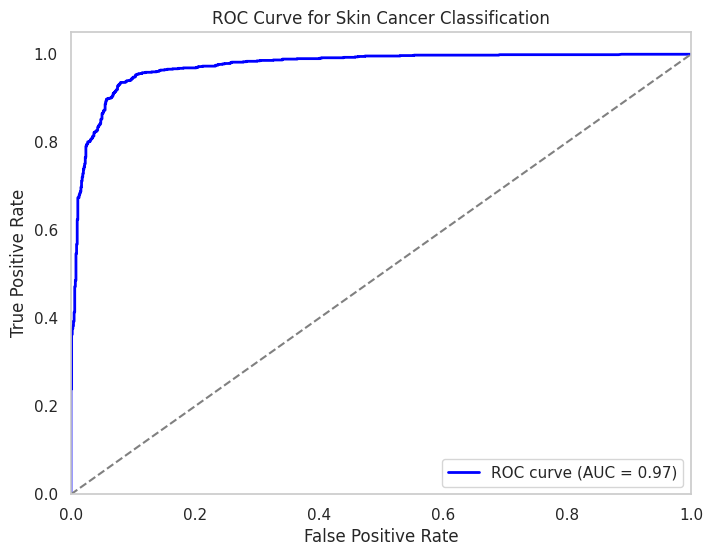

In [101]:
plot_roc_curve(y_true, y_probs)

## 5. Post-processing

After model inference, post-processing is crucial for optimizing performance based on the specific use case. 

Adjusting the decision threshold allows for control over the trade-off between false alarms and missed detections:

- **Low False Alarms:** A higher threshold ensures that only high-confidence predictions are accepted, reducing false positives but potentially increasing missed detections.
- **Low Misses:** A lower threshold captures more positive cases, minimizing false negatives but at the cost of increasing false positives.

The threshold should be fine-tuned based on the application's requirements to achieve the desired balance between precision and recall.


In [51]:
optimal_threshold = 0.3  # Lower threshold for higher recall
y_preds_adjusted = (y_probs >= optimal_threshold).astype(int)

newcm= confusion_matrix(y_true, y_preds_adjusted)
calc_metrics(newcm)

FP (Misclassify) = 111, FN (Missed) = 43
Precision: 89.61
Recall: 95.70


## Conclusion: DenseNet121 vs ResNet50

Based on the F1 scores, DenseNet121 outperformed ResNet50 with a score of 92.65 compared to 90.22. 

This difference in performance can be attributed to the following factors:

1. Deeper Architecture: DenseNet121 has a more complex architecture with significantly more layers than ResNet50. The increased depth allows DenseNet121 to capture more intricate patterns and features from the data, which contributes to its higher performance.

2. Dense Connectivity: DenseNet121 benefits from its densely connected layers, where each layer receives input from all previous layers. This design improves feature reuse and helps the model learn richer representations, leading to better generalization.

In conclusion, the DenseNet121 model, with its deeper architecture and dense connections, showed superior performance over ResNet50, as reflected in the higher F1 score. This makes DenseNet121 a more suitable choice for tasks requiring a more complex and expressive model.